# Exploración de datos

## Imports

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go

## Read file

In [69]:
df = pd.read_csv('../data/train.csv')

Se podrían cargar nuevas features y realizar todo este mismo análisis sumando nuevas potenciales variables predictoras útiles.

In [70]:
def addFeatures(df):
    # Nuevas features
    jardin = []
    terraza = []
    seguridad = []
    luminoso = []

    # Procesamiento
    for i in range(len(df)):
        descripcion = df["descripcion"][i]
        if not isinstance(descripcion, str):
            jardin.append(0)
        else:
            palabras = ["jardin","jardín","garden","parque","jard&iacute;"]
            jardin.append(int(any([word in descripcion for word in palabras])))
        if not isinstance(descripcion, str):
            terraza.append(0)
        else:
            palabras = ["terraza"]
            terraza.append(int(any([word in descripcion for word in palabras])))
        if not isinstance(descripcion, str):
            seguridad.append(0)
        else:
            palabras = ["seguridad", "vigilancia", "alarma"]
            seguridad.append(int(any([word in descripcion for word in palabras])))
        if not isinstance(descripcion, str):
            luminoso.append(0)
        else:
            palabras = ["luminoso", "luminosidad", "iluminación", "iluminacion"]
            luminoso.append(int(any([word in descripcion for word in palabras])))

    df.insert(len(list(df))-1, "jardin", jardin, True) 
    df.insert(len(list(df))-1, "terraza", terraza, True) 
    df.insert(len(list(df))-1, "seguridad", seguridad, True) 
    df.insert(len(list(df))-1, "luminoso", luminoso, True) 
    
    return df
            
# Resultados (Sorpresivos)
df = addFeatures(df)

df

,id,titulo,descripcion,tipodepropiedad,direccion,ciudad,provincia,antiguedad,habitaciones,garages,...,gimnasio,usosmultiples,piscina,escuelascercanas,centroscomercialescercanos,jardin,terraza,seguridad,luminoso,precio
0,254099,depto. tipo a-402,"depto. interior de 80.15m2, consta de sala com...",Apartamento,Avenida Division del Norte 2005,Benito Juárez,Distrito Federal,NaN,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,0,2273000.0
1,53461,condominio horizontal en venta,"<p>entre sonora y guerrero, atr&aacute;s del h...",Casa en condominio,AV. MEXICO,La Magdalena Contreras,Distrito Federal,10.0,3.0,2.0,...,0.0,0.0,0.0,1.0,1.0,0,1,0,0,3600000.0
2,247984,casa en venta urbi 3 recamaras tonala,descripcion \nla mejor ubicacion residencial e...,Casa,Urbi Tonala,Tonalá,Jalisco,5.0,3.0,2.0,...,0.0,0.0,0.0,0.0,0.0,1,0,1,0,1200000.0
3,209067,casa sola en toluca zinacantepec con credito i...,casa en privada con caseta de vigilancia casas...,Casa,IGNACIO MANUEL ALTAMIRANO 128,Zinacantepec,Edo. de México,1.0,2.0,1.0,...,0.0,0.0,0.0,1.0,1.0,0,0,1,0,650000.0
4,185997,paseos del sol,bonito departamento en excelentes condiciones ...,Apartamento,PASEOS DEL SOL,Zapopan,Jalisco,10.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0,0,0,0,1150000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239995,119879,bonita casas de 2 recamaras a 10 minutos del c...,vendo casa en bosques de ica residencial a 10 ...,Casa,BOSQUES,Zinacantepec,Edo. de México,0.0,2.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0,0,1,0,650000.0
239996,259178,casa en condominio a 10 min. del centro de toluca,"casa con un jardin amplio, un cuarto de servic...",Casa,Filiberto Navas 325,Toluca,Edo. de México,0.0,3.0,3.0,...,0.0,0.0,0.0,1.0,1.0,1,0,0,0,1940000.0
239997,131932,nicolas san juan,"departamento con excelente ubicación, muy cerc...",Apartamento,Nicolas San Juan,Benito Juárez,Distrito Federal,20.0,2.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1,0,1,0,3400000.0
239998,146867,casa sola. javier rojo gomez.,"casa sola, dividida en cuatro departamentos de...",Casa,Javier Rojo Gomez 120,Iztapalapa,Distrito Federal,20.0,4.0,0.0,...,1.0,0.0,0.0,1.0,1.0,0,0,0,0,2890000.0


In [71]:
def addSecurityFeatures(df):
    # Agregamos información de una base de datos externa
    df_indices_seg = df[["provincia","fecha"]]
    df_indices_seg = df_indices_seg[(~df_indices_seg.isnull()).all(axis=1)]

    # Percepción de la seguridad por Provincia (Estado)
    indice_2012 = [46.5,51.6,24.4,44.6,74.6,70.8,37.9,82.7,70.8,81.8,54.1,74.4,49.2,61.5,84.5,76.0,81.2,72.9,86.7,60.7,57.1,29.4,59.9,60.0,77.4,42.4,71.2,82.9,40.1,70.0,19.2,80.5]
    indice_2013 = [45.4,46.4,69.2,40.2,16.9,28.2,45.7,18.5,26.2,19.5,37.9,9.6,39.3,23.3,8.3,16.5,12.5,42.6,19.6,31.1,32.1,55.9,27.7,19.3,21.4,47.3,15.0,13.5,45.8,22.0,67.0,14.6]
    indice_2014 = [48.2,41.5,59.0,38.7,19.9,41.7,36.0,22.2,22.1,23.6,31.8,18.9,31.5,31.0,6.4,16.3,10.6,47.1,25.6,20.6,34.0,59.3,30.4,24.9,26.5,41.6,13.2,13.4,36.6,16.9,69.6,18.5]
    indice_2015_con_limites = [(62.2,67.1),(55.6,59.7),(59.1,63.1),(60.8,65.8),(62.1,66.4),(65.2,69.0),(65.7,69.6),(69.7,73.6),(48.6,53.7),(64.6,68.5),(47.5,52.6),(56.5,61.5),(54.5,59.5),(58.1,62.4),(31.5,36.0),(62.0,65.6),(43.6,48.0),(71.0,75.8),(57.9,61.7),(59.6,64.8),(54.2,57.9),(54.2,58.6),(54.6,59.0),(60.8,65.8),(66.2,69.9),(55.7,61.4),(35.9,40.3),(57.2,61.0),(50.5,55.3),(55.0,59.0),(64.4,68.4),(59.4,64.7)]
    indice_2015 = []
    for t in indice_2015_con_limites :
        indice_2015.append((t[0]+t[1])/2)

    indice_2016_con_limites = [(58.4,63.6),(54.2,58.3),(66.5,70.1),(60.1,64.3),(68.6,72.4),(52.7,56.4),(63.5,67.2),(69.2,73.6),(40.4,45.4),(70.2,73.5),(49.5,54.6),(56.6,61.3),(56.4,61.1),(54.7,59.2),(30.0,34.1),(64.0,68.2),(43.6,48.2),(75.7,79.4),(59.2,63.2),(62.0,66.9),(46.6,50.4),(50.9,55.2),(53.7,57.9),(60.4,66.2),(69.7,73.3),(56.6,62.1),(33.7,38.0),(56.5,60.3),(54.3,58.5),(53.1,57.3),(64.4,68.0),(58.3,63.5)]
    indice_2016 = []
    for t in indice_2016_con_limites :
        indice_2016.append((t[0]+t[1])/2)

    # Estados en el orden que aparecen los datos en cada índice
    estados = ["Aguascalientes","Baja California Norte","Baja California Sur","Campeche","Coahuila","Colima","Chiapas","Chihuahua","Distrito Federal","Durango","Guanajuato","Guerrero","Hidalgo","Jalisco","Edo. de México","Michoacán","Morelos","Nayarit","Nuevo León","Oaxaca","Puebla","Querétaro","Quintana Roo","San luis Potosí","Sinaloa","Sonora","Tabasco","Tamaulipas","Tlaxcala","Veracruz","Yucatán","Zacatecas"]

    lista = []
    indice_inseguridad = []

    for index, row in df_indices_seg.iterrows():
        lista.append((row["provincia"],row["fecha"]))

    for i in range(len(lista)):
        if("2012" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_inseguridad.append(indice_2012[j])
                    break

        elif("2013" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_inseguridad.append(indice_2013[j])
                    break

        elif("2014" in lista[i][1]):    
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_inseguridad.append(indice_2014[j])
                    break

        elif("2015" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_inseguridad.append(indice_2015[j])
                    break

        elif("2016" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_inseguridad.append(indice_2016[j])
                    break

    return indice_inseguridad

In [72]:
def addInfractionsFeature(df):
    # CALCULAMOS CON LA TASA MEDIA DE CRECIMIENTO POBLACIONAL ENTRE 2010-2015
    df_indices_seg = df[["provincia","fecha"]]
    df_indices_seg = df_indices_seg[(~df_indices_seg.isnull()).all(axis=1)]
    
    # Población por provincia por año
    poblacion_total_2012 = obtener_poblacion(2)
    poblacion_total_2013 = obtener_poblacion(3)
    poblacion_total_2014 = obtener_poblacion(4)
    poblacion_total_2015 = obtener_poblacion(5)
    poblacion_total_2016 = obtener_poblacion(6)
    
    # Reporte de infracciones por año
    infracciones_2012 = [ 4474, 5046, 6208, 6907, 2079, 6008, 7918, 7942,1046967,  878, 5137, 3635, 38833, 2982, 33949, 11528, 4416, 16840, 8141, 8081,  835, 3190, 4403, 15979,  455,  649, 5025, 1701, 2934, 11810, 19653,  130]
    infracciones_2012 = regularizacion_de_infracciones(poblacion_total_2012, infracciones_2012)

    infracciones_2013 = [ 19985, 4618, 9423, 19957, 1494, 6011, 11319, 4797,1200784,  626,1329, 6263, 43471, 2793, 31583, 9257, 4455, 3180, 15841, 11090, 8395, 4392, 3646, 19562, 3654, 1732, 4854, 22072, 1753, 12056, 20826,  140]
    infracciones_2013 = regularizacion_de_infracciones(poblacion_total_2013, infracciones_2013)

    infracciones_2014 = [ 19617, 4232,  946, 26561, 12621, 4727, 9187, 5278, 592135, 5525, 1090, 4013, 38962, 2391, 36331, 9994, 6335,  902, 10078, 8374, 4389, 1206, 4077, 26382,  701, 2871, 4011, 25356, 2310, 14498, 22606,  175]
    infracciones_2014 = regularizacion_de_infracciones(poblacion_total_2014, infracciones_2014)

    infracciones_2015 = [ 19729, 3106, 1188, 26980, 22375, 6388, 8816, 6208, 198094, 16017, 1174, 3895, 32931, 3569, 25357, 3920, 10969, 2148, 10618, 5931, 1822, 1708, 3404, 22169,  735, 1833, 6719, 29556, 3810, 16538, 264264,  216]
    infracciones_2015 = regularizacion_de_infracciones(poblacion_total_2015, infracciones_2015)

    infracciones_2016 = [ 69886, 2652,  796, 21101, 19304, 4547, 8799, 8525, 205320, 23752, 93899, 13552, 5548, 3459, 34539, 44615, 29294,  476, 9082, 6809, 1649, 36824, 12806, 20372,  707, 1365, 10846, 34944, 3945, 17176, 260592,  224]
    infracciones_2016 = regularizacion_de_infracciones(poblacion_total_2016, infracciones_2016)

    # Estados
    estados = ["Aguascalientes","Baja California Norte","Baja California Sur","Campeche","Coahuila","Colima","Chiapas","Chihuahua","Distrito Federal","Durango","Guanajuato","Guerrero","Hidalgo","Jalisco","Edo. de México","Michoacán","Morelos","Nayarit","Nuevo León","Oaxaca","Puebla","Querétaro","Quintana Roo","San luis Potosí","Sinaloa","Sonora","Tabasco","Tamaulipas","Tlaxcala","Veracruz","Yucatán","Zacatecas"]
    
    lista = []
    indice_infracciones = []

    for index, row in df_indices_seg.iterrows():
        lista.append((row["provincia"],row["fecha"]))

    for i in range(len(lista)):
        if("2012" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_infracciones.append(infracciones_2012[j])
                    break

        elif("2013" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_infracciones.append(infracciones_2013[j])
                    break

        elif("2014" in lista[i][1]) :
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_infracciones.append(infracciones_2014[j])
                    break

        elif("2015" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_infracciones.append(infracciones_2015[j])
                    break

        elif("2016" in lista[i][1]):
            for j in range(len(estados)):
                if estados[j].lower() in lista[i][0].lower():
                    indice_infracciones.append(infracciones_2016[j])
                    break

    return indice_infracciones

def obtener_poblacion(n):
    poblacion_total_2010 = [1184996,3155070,637026,822441,2748391,650555,4796580,3406465,8851080,1632934,5486372,3388768,2665018,7350682,1517862,4351037,1777227,1084979,4653458,3801962,5779829,1827937,1325578,2585518,2767761,2662480,2238603,3268554,1169936,7643194,1955577,1490668]
    tasa_de_crecimiento  = [2.2,1.3,2.6,2,1.6,2,1.8,1,0.3,1.6,1.4,0.9,1.5,1.5,1.4,1.2,1.6,1.9,2.1,0.9,1.4,2.4,2.7,1.1,1.5,1.6,1.5,1.2,1.8,1.3,1.5,1.3]
    poblacion = []
    for i in range(len(poblacion_total_2010)):
        poblacion.append(poblacion_total_2010[i] * tasa_de_crecimiento[i]*n)

    return poblacion

# Datos de infracciones registradas por intervenciones de la policía por Provincia (Estado)
def regularizacion_de_infracciones(poblacion_total, infracciones):
    rv = []
    for i in range(len(infracciones)) :
        #el dato que ingresamos es la cantidad de infracciones cada 1000 habitantes
        rv.append(infracciones[i] * 1000 / poblacion_total[i])
    return rv

In [73]:
indice_seguridad = addSecurityFeatures(df)
infracciones     = addInfractionsFeature(df)

df = df.dropna(subset=["provincia"])
df.insert(len(list(df))-1, "infracciones", infracciones, True) 
df.insert(len(list(df))-1, "indice_seguridad", indice_seguridad, True) 
df

,id,titulo,descripcion,tipodepropiedad,direccion,ciudad,provincia,antiguedad,habitaciones,garages,...,piscina,escuelascercanas,centroscomercialescercanos,jardin,terraza,seguridad,luminoso,infracciones,indice_seguridad,precio
0,254099,depto. tipo a-402,"depto. interior de 80.15m2, consta de sala com...",Apartamento,Avenida Division del Norte 2005,Benito Juárez,Distrito Federal,NaN,2.0,1.0,...,0.0,0.0,0.0,0,0,0,0,14.920514,51.15,2273000.0
1,53461,condominio horizontal en venta,"<p>entre sonora y guerrero, atr&aacute;s del h...",Casa en condominio,AV. MEXICO,La Magdalena Contreras,Distrito Federal,10.0,3.0,2.0,...,0.0,1.0,1.0,0,1,0,0,150.739169,26.20,3600000.0
2,247984,casa en venta urbi 3 recamaras tonala,descripcion \nla mejor ubicacion residencial e...,Casa,Urbi Tonala,Tonalá,Jalisco,5.0,3.0,2.0,...,0.0,0.0,0.0,1,0,1,0,0.064738,60.25,1200000.0
3,209067,casa sola en toluca zinacantepec con credito i...,casa en privada con caseta de vigilancia casas...,Casa,IGNACIO MANUEL ALTAMIRANO 128,Zinacantepec,Edo. de México,1.0,2.0,1.0,...,0.0,1.0,1.0,0,0,1,0,7.987974,84.50,650000.0
4,185997,paseos del sol,bonito departamento en excelentes condiciones ...,Apartamento,PASEOS DEL SOL,Zapopan,Jalisco,10.0,2.0,1.0,...,0.0,0.0,0.0,0,0,0,0,0.052285,56.95,1150000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239995,119879,bonita casas de 2 recamaras a 10 minutos del c...,vendo casa en bosques de ica residencial a 10 ...,Casa,BOSQUES,Zinacantepec,Edo. de México,0.0,2.0,2.0,...,0.0,0.0,0.0,0,0,1,0,2.386534,33.75,650000.0
239996,259178,casa en condominio a 10 min. del centro de toluca,"casa con un jardin amplio, un cuarto de servic...",Casa,Filiberto Navas 325,Toluca,Edo. de México,0.0,3.0,3.0,...,0.0,1.0,1.0,1,0,0,0,4.274222,6.40,1940000.0
239997,131932,nicolas san juan,"departamento con excelente ubicación, muy cerc...",Apartamento,Nicolas San Juan,Benito Juárez,Distrito Federal,20.0,2.0,1.0,...,0.0,0.0,0.0,1,0,1,0,14.920514,51.15,3400000.0
239998,146867,casa sola. javier rojo gomez.,"casa sola, dividida en cuatro departamentos de...",Casa,Javier Rojo Gomez 120,Iztapalapa,Distrito Federal,20.0,4.0,0.0,...,0.0,1.0,1.0,0,0,0,0,55.749788,22.10,2890000.0


## Análisis inicial

Primero observamos más o menos la forma de la matriz de datos.

In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 239845 entries, 0 to 239999
Data columns (total 29 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   id                          239845 non-null  int64  
 1   titulo                      234458 non-null  object 
 2   descripcion                 238249 non-null  object 
 3   tipodepropiedad             239801 non-null  object 
 4   direccion                   186861 non-null  object 
 5   ciudad                      239628 non-null  object 
 6   provincia                   239845 non-null  object 
 7   antiguedad                  196394 non-null  float64
 8   habitaciones                217396 non-null  float64
 9   garages                     202153 non-null  float64
 10  banos                       213700 non-null  float64
 11  metroscubiertos             222473 non-null  float64
 12  metrostotales               188424 non-null  float64
 13  idzona        

Se observa que en varias variables de potencial uso predictor se tienen bastantes celdas en `NaN`. Una opción sería realizar un `df.dropna()` para eliminar dichas entradas, pues nos traerán problemas con los cálculos, pero eso lleva a que perdamos información sobre el resto de las features de esa entrada.

In [75]:
df_drop = df.dropna()

df_drop.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49881 entries, 1 to 239998
Data columns (total 29 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          49881 non-null  int64  
 1   titulo                      49881 non-null  object 
 2   descripcion                 49881 non-null  object 
 3   tipodepropiedad             49881 non-null  object 
 4   direccion                   49881 non-null  object 
 5   ciudad                      49881 non-null  object 
 6   provincia                   49881 non-null  object 
 7   antiguedad                  49881 non-null  float64
 8   habitaciones                49881 non-null  float64
 9   garages                     49881 non-null  float64
 10  banos                       49881 non-null  float64
 11  metroscubiertos             49881 non-null  float64
 12  metrostotales               49881 non-null  float64
 13  idzona                      49

Se ve que pasamos de tener 240.000 entradas a tener ~50.000. Estamos perdiendo el ~80% de las entradas. Si nos deshiciéramos primero de las variables latitud y longitud que tienen cerca del 50% de las entradas en `NaN`

In [76]:
df.drop(["lat","lng"], axis=1).dropna().info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 99084 entries, 1 to 239998
Data columns (total 27 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          99084 non-null  int64  
 1   titulo                      99084 non-null  object 
 2   descripcion                 99084 non-null  object 
 3   tipodepropiedad             99084 non-null  object 
 4   direccion                   99084 non-null  object 
 5   ciudad                      99084 non-null  object 
 6   provincia                   99084 non-null  object 
 7   antiguedad                  99084 non-null  float64
 8   habitaciones                99084 non-null  float64
 9   garages                     99084 non-null  float64
 10  banos                       99084 non-null  float64
 11  metroscubiertos             99084 non-null  float64
 12  metrostotales               99084 non-null  float64
 13  idzona                      99

De esta manera perdemos menos entradas, pero no vamos a poder utilizar la información geográfica para las predicciones.

Otra opción sería completar los valores ausentes de manera que puedan utilizarse las entradas perdidas. Una manera de hacer esto sería completando con la _mediana_ de cada _feature_.

In [77]:
variables = ["tipodepropiedad", "provincia", "antiguedad", "habitaciones", "banos", "metroscubiertos", "metrostotales", "gimnasio", "usosmultiples", "piscina", "escuelascercanas", "centroscomercialescercanos", "terraza", "jardin", "seguridad", "luminoso", "infracciones", "indice_seguridad", "lat", "lng", "idzona", "precio"]

df_sin_nan = df[variables]
df_sin_nan = df_sin_nan[df_sin_nan['tipodepropiedad'].notnull()]
df_sin_nan = df_sin_nan[df_sin_nan['provincia'].notnull()]

df_sin_nan = df_sin_nan.fillna(df_sin_nan.median())

df_sin_nan

,tipodepropiedad,provincia,antiguedad,habitaciones,banos,metroscubiertos,metrostotales,gimnasio,usosmultiples,piscina,...,terraza,jardin,seguridad,luminoso,infracciones,indice_seguridad,lat,lng,idzona,precio
0,Apartamento,Distrito Federal,5.0,2.0,2.0,80.0,80.0,0.0,0.0,0.0,...,0,0,0,0,14.920514,51.15,19.543143,-99.240348,23533.0,2273000.0
1,Casa en condominio,Distrito Federal,10.0,3.0,2.0,268.0,180.0,0.0,0.0,0.0,...,1,0,0,0,150.739169,26.20,19.310205,-99.227655,24514.0,3600000.0
2,Casa,Jalisco,5.0,3.0,2.0,144.0,166.0,0.0,0.0,0.0,...,0,1,1,0,0.064738,60.25,19.543143,-99.240348,48551.0,1200000.0
3,Casa,Edo. de México,1.0,2.0,1.0,63.0,67.0,0.0,0.0,0.0,...,0,0,1,0,7.987974,84.50,19.301890,-99.688015,53666.0,650000.0
4,Apartamento,Jalisco,10.0,2.0,1.0,95.0,95.0,0.0,0.0,0.0,...,0,0,0,0,0.052285,56.95,19.543143,-99.240348,47835.0,1150000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239995,Casa,Edo. de México,0.0,2.0,1.0,67.0,155.0,0.0,0.0,0.0,...,0,0,1,0,2.386534,33.75,19.543143,-99.240348,53666.0,650000.0
239996,Casa,Edo. de México,0.0,3.0,3.0,200.0,250.0,0.0,0.0,0.0,...,0,1,0,0,4.274222,6.40,19.294665,-99.692916,51954.0,1940000.0
239997,Apartamento,Distrito Federal,20.0,2.0,2.0,138.0,138.0,0.0,0.0,0.0,...,0,1,1,0,14.920514,51.15,19.543143,-99.240348,50003995.0,3400000.0
239998,Casa,Distrito Federal,20.0,4.0,4.0,235.0,137.0,1.0,0.0,0.0,...,0,0,0,0,55.749788,22.10,19.366651,-99.082246,24162.0,2890000.0


Corresponde separar la base de datos entre los **features** o variables predictoras y el **target** o variable a predecir.

In [78]:
# Variable target
prices = df["precio"]

# Modelo dropeando los NaN
features_drop = df_drop[variables[:-1]]
features_nan  = df_sin_nan[variables[:-1]]

### Un poco de exploración de datos

In [79]:
# Minimum price of the data
minimum_price = np.amin(prices)

# Maximum price of the data
maximum_price = np.amax(prices)

# Mean price of the data
mean_price = np.mean(prices)

# Median price of the data
median_price = np.median(prices)

# Standard deviation of prices of the data
std_price = np.std(prices)

# Show the calculated statistics
print("Statistics for Boston housing dataset:\n")
print("Minimum price: ${:.2f}".format(minimum_price)) 
print("Maximum price: ${:.2f}".format(maximum_price))
print("Mean price: ${:.2f}".format(mean_price))
print("Median price ${:.2f}".format(median_price))
print("Standard deviation of prices: ${:.2f}".format(std_price))

Statistics for Boston housing dataset:

Minimum price: $310000.00
Maximum price: $12525000.00
Mean price: $2530555.82
Median price $1850000.00
Standard deviation of prices: $2152507.06


Las siguientes gráficas nos muestran la distribución de cada variable (diagonal) y luego un gráfico de dispersión de a pares entre variables. Los gráficos de a pares no parecen arrojar mucha luz sobre el modelado.

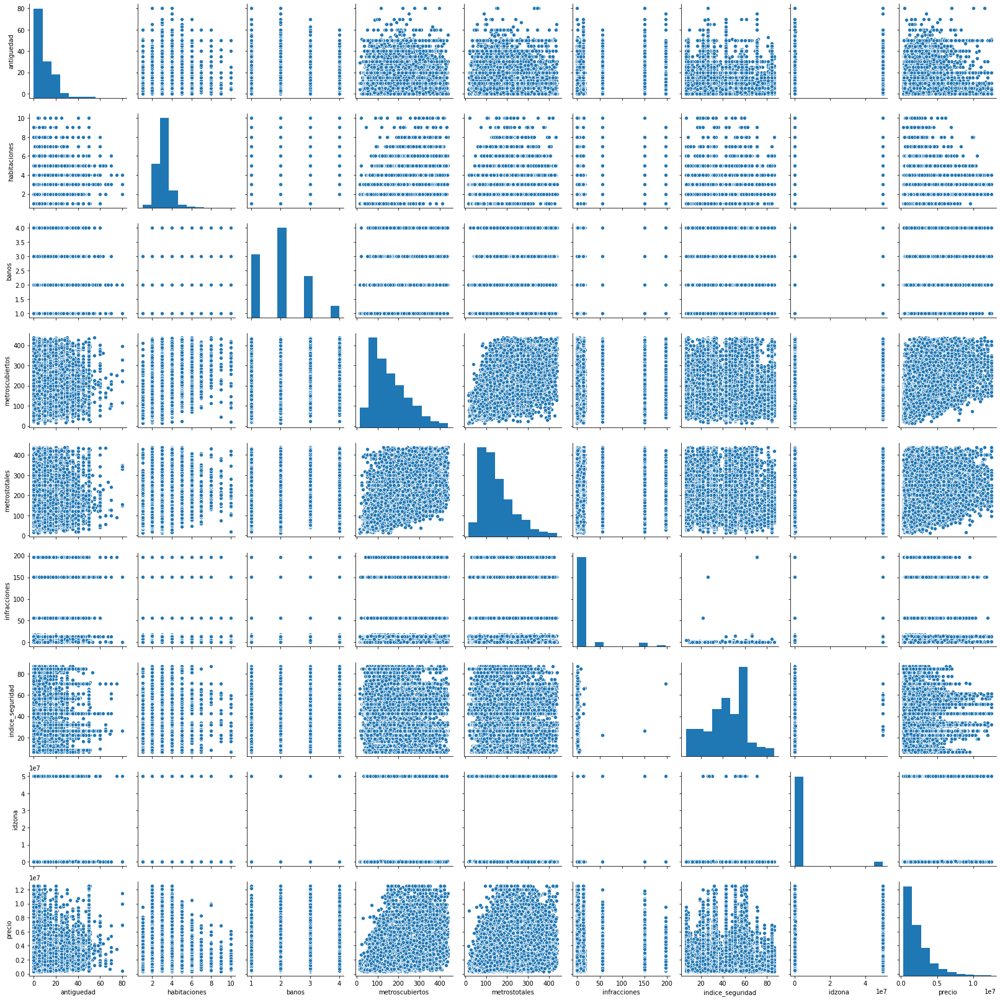

In [80]:
# Calculate and show pairplot
plotVar = ["tipodepropiedad", "provincia", "antiguedad", "habitaciones", "banos", "metroscubiertos", "metrostotales", "infracciones", "indice_seguridad", "idzona", "precio"]
data = df_drop[plotVar]

sns.pairplot(data, height=2.5)
plt.tight_layout()

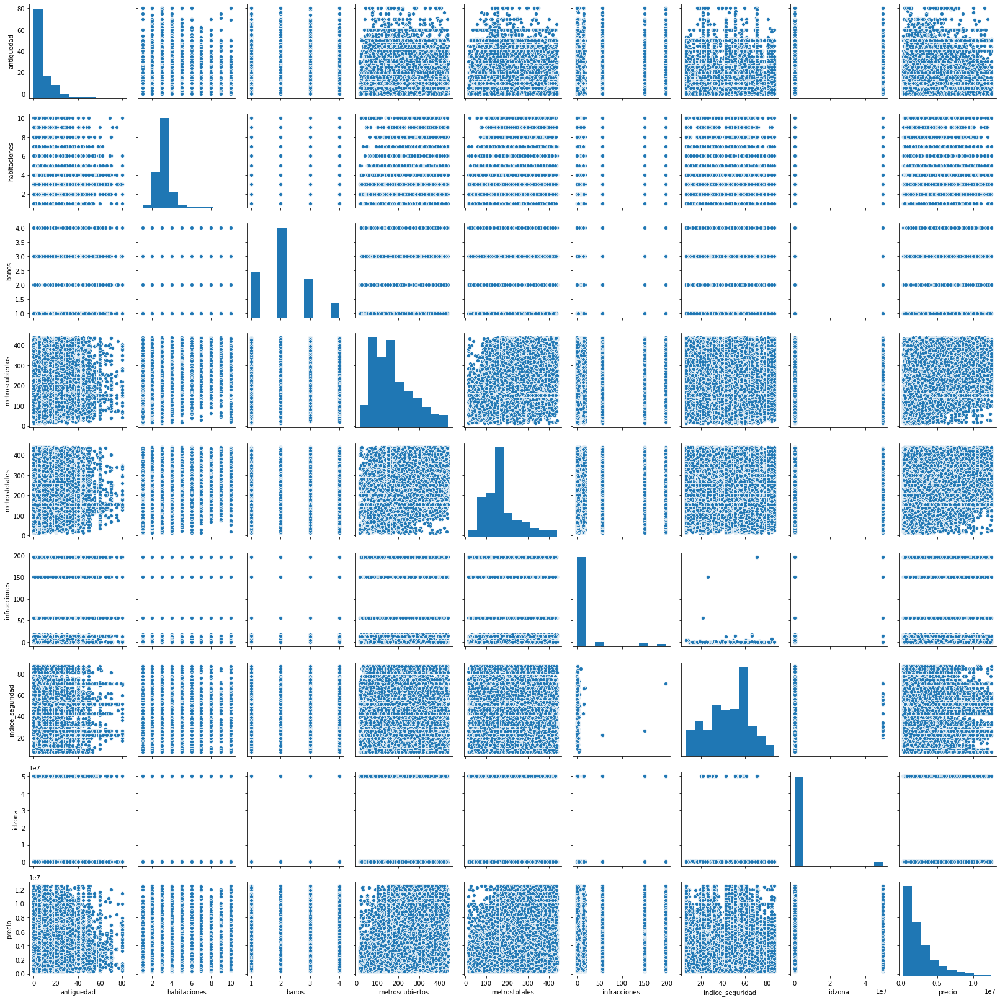

In [81]:
data = df_sin_nan[plotVar]

sns.pairplot(data, height=2.5)
plt.tight_layout()

El siguiente paso, sería analizar el grado de correlación que hay entre nuestras variables. De esta manera podremos encontrar cuál es la variable más correlacionada con el precio, pero además podremos encontrar variables altamente correlacionadas entre sí, lo que implicará que en caso de agregar una de ellas a nuestro modelo, luego la otra no brindará información nueva (independiente).

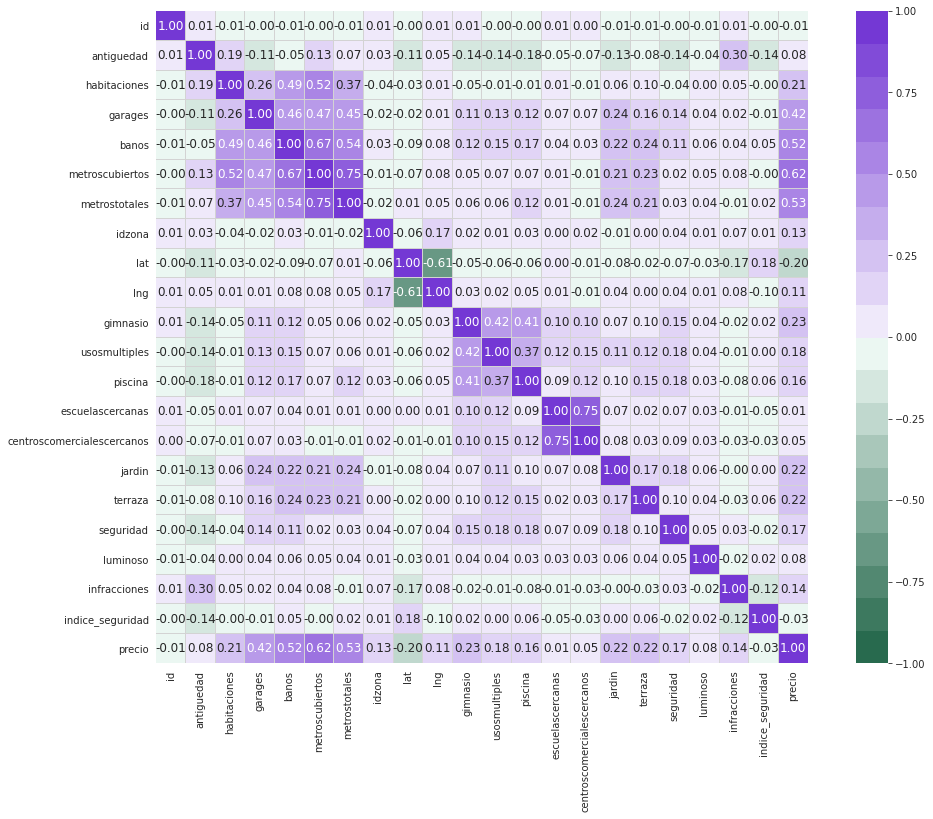

In [82]:
# Correlación entre variables
correlation = df_drop.corr()

paleta = sns.diverging_palette(150, 275, s=80, l=40, n=20)

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(17, 12))
    ax = sns.heatmap(correlation,
                     annot=True,
                     annot_kws={'size': 12},
                     fmt='.2f',
                     vmax=1, 
                     vmin=-1, 
                     square=True, 
                     linewidths=.01, 
                     linecolor='lightgray', 
                     cmap=paleta)

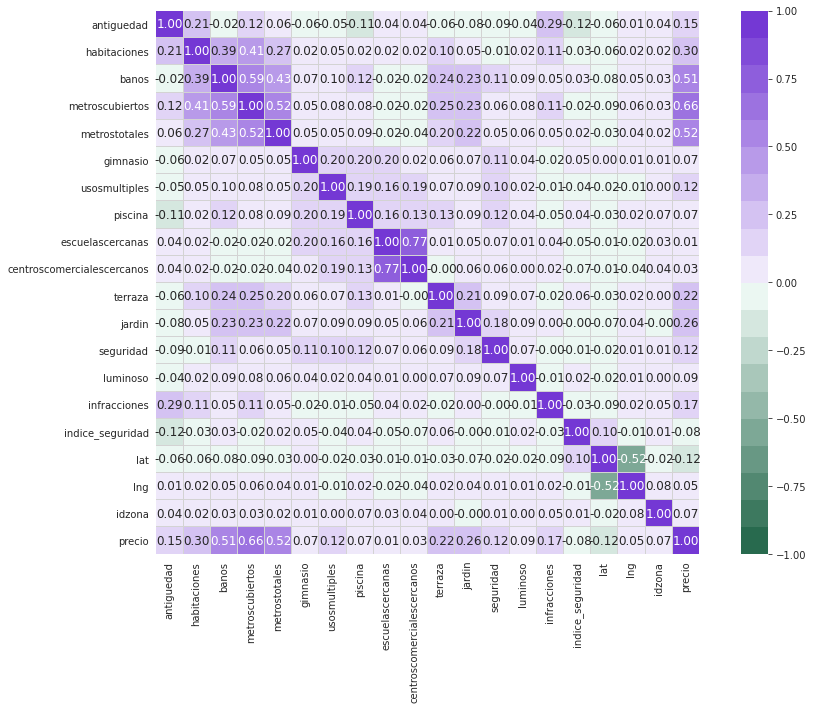

In [87]:
# Correlación entre variables
correlation = df_sin_nan[df_sin_nan["tipodepropiedad"] == "Casa"].corr()

paleta = sns.diverging_palette(150, 275, s=80, l=40, n=20)

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15, 10))
    ax = sns.heatmap(correlation,
                     annot=True,
                     annot_kws={'size': 12},
                     fmt='.2f',
                     vmax=1, 
                     vmin=-1, 
                     square=True, 
                     linewidths=.01, 
                     linecolor='lightgray', 
                     cmap=paleta)

Como última instancia resulta interesante ver cuántos representantes de cada provincia hay y cuál es la distribución de precios dentro de cada una.

In [51]:
df_drop["provincia"].value_counts()

Distrito Federal         14424
Edo. de México            8901
Jalisco                   7494
Querétaro                 3291
Puebla                    2232
Nuevo León                2071
Baja California Norte     1114
Morelos                   1039
San luis Potosí            918
Veracruz                   914
Coahuila                   748
Quintana Roo               735
Hidalgo                    618
Aguascalientes             612
Guanajuato                 548
Yucatán                    539
Guerrero                   432
Sonora                     425
Chihuahua                  416
Michoacán                  319
Sinaloa                    289
Durango                    286
Colima                     241
Nayarit                    235
Baja California Sur        208
Tlaxcala                   194
Chiapas                    171
Tabasco                    162
Oaxaca                     152
Tamaulipas                  90
Zacatecas                   39
Campeche                    24
Name: pr

In [52]:
df_sin_nan["provincia"].value_counts()

Distrito Federal         58790
Edo. de México           41604
Jalisco                  21238
Querétaro                16988
Nuevo León               15324
Puebla                   10421
San luis Potosí           8411
Yucatán                   7925
Morelos                   7337
Veracruz                  5760
Quintana Roo              4756
Chihuahua                 4590
Coahuila                  3695
Baja California Norte     3220
Sonora                    2988
Guanajuato                2860
Guerrero                  2678
Hidalgo                   2521
Michoacán                 2471
Tamaulipas                2303
Durango                   2275
Sinaloa                   1806
Aguascalientes            1753
Baja California Sur       1700
Nayarit                   1352
Chiapas                   1126
Colima                    1008
Tabasco                    994
Tlaxcala                   839
Oaxaca                     711
Campeche                   263
Zacatecas                   94
Name: pr

In [53]:
df_sorted = df_sin_nan.sort_values(by=["provincia"])
promedios = df_sorted.groupby(['provincia'])["precio"].median()
df_sorted = df_sorted.set_index(['provincia']) # make the same index here
df_sorted['promedio_precio'] = promedios
df_sorted = df_sorted.reset_index() # to take the hierarchical index off again
df_sorted = df_sorted.sort_values(by=["promedio_precio"])

provincias = df["provincia"].unique()

c = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, len(provincias))]

fig = go.Figure(go.Box(
    y = df_sorted["precio"],
    x = df_sorted["provincia"],
))

fig.update_layout(
    xaxis = dict(title = 'Provincia', zeroline=False),
    yaxis = dict(title = "Precio", zeroline=False),
    boxmode = 'group',
    width = 1200,
    height = 800
)

fig.show()

Viendo la distribución de precios y la cantidad de publicaciones que hay en algunos estados, quizás sea interesante presentar un modelado, por ejemplo, sólo para _Distrito Federal_ o algún otro Estado con muchas entradas.